# Data Prep and Modelling

In [37]:
import pandas as pd
from IPython.display import HTML
display(HTML("<style>.container { width:100% !important; }</style>")) ### This line makes our Jupyter notebook use the entire width of the screen

# Functions

## make_corpus (unused so far)

In [34]:
def make_corpus(dataset, column):
    '''This function reads in a pandas dataframe (dataset) and the column name (e.g. 'text_column'). 
    Then it strips all punctuation, makes it lower case, tokenizes it, and removes english stopwords. 
    Finally it returns two lists (either directly or via tuple unpacking. the first is the documents
    without stopwords; the second is the documents stemmed via porterstemmer.
    '''
    from nltk.corpus import stopwords
    from nltk.tokenize import word_tokenize
    stop_words = set(stopwords.words('english'))
    import string 
    import sys
    translator = str.maketrans('', '', string.punctuation)
    import re
    from nltk.stem import PorterStemmer
    ps = PorterStemmer()
    filtered_text_list = []
    stemmed_text_list = []
    for i in range (0, len(dataset)):
        text = dataset.iloc[i][column].lower().translate(translator)
        text = re.sub('\n', ' ', text)
        word_tokens = word_tokenize(text) 
        filtered_text = [w for w in word_tokens if not w in stop_words]
        filtered_text = []
        for w in word_tokens:
            if w not in stop_words:
                filtered_text.append(w)
        stemmed_text = []
        for w in filtered_text:
            stemmed_text.append(ps.stem(w))
        filtered_text_list.append(str(filtered_text).translate(translator))
        stemmed_text_list.append(str(stemmed_text).translate(translator))
        sys.stdout.write("\r" + "Creating Corpus.. Processing Record: " + str(i+1) + " of " + str(len(dataset)))
        sys.stdout.flush()
    print("\nDONE!")
    return filtered_text_list, stemmed_text_list

## wordcloud
wordcloud has been heavily tweaked to create super high DPI images, and therefore takes a long time to render.

In [21]:
def wordcloud(text):
    #d = path.dirname(__file__)
    #ottawa_mask = np.array(Image.open(path.join(d, "kpzQuih.jpg")))
    from wordcloud import WordCloud
    import matplotlib.pyplot as plt
    wordcloud = WordCloud(font_path='/Library/Fonts/Graphik-thin.ttf',
                          collocations=False,
                          max_words = 300,
                          width = 4192,
                          height = 3684,
                          background_color="white",
                          ).generate(text)
    plt.figure(figsize=(30,30), dpi=300)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    return;

## extract_topics
This used the sklearn TFIDF vectorizer to extract topics from text. We limite the features to reduce noise. This may be a bad idea, but we'll find out via experimentation.

In [35]:
def extract_topics(documents, no_features):
    '''Reads in a document and the number of features to extract. returns the extracted topics using TFIDF_Vectorizer'''
    from sklearn.feature_extraction.text import TfidfVectorizer
    #from sklearn.decomposition import NMF, LatentDirichletAllocation    
    #from sklearn.feature_extraction.text import TfidfVectorizer
    tfidf_vectorizer = TfidfVectorizer(max_features=no_features, stop_words='english')
    tfidf = tfidf_vectorizer.fit_transform([documents])
    tfidf_feature_names = tfidf_vectorizer.get_feature_names()
    return tfidf_feature_names

# Running Code

## Load the dataframe from a pickle (binary) format to avoid CSV bleed

In [24]:
dataset = pd.read_pickle('other_xmltodict_all_major_fields.pkl')
print("With Null rows: " + str(len(dataset)))
### Drop the rows with no values in section_bodies
dataset = dataset[dataset['section_bodies'] != 'Null']
print("Without Null rows: " + str(len(dataset)))

With Null rows: 4109
Without Null rows: 2520


In [25]:
dataset.head()

,consolidation_date,enabling_authority,enabling_type,file_name,instrument_number,language,last_modified_date,order_number,registration_date,regulation_maker,regulation_provision,regulation_type,repealed,section_bodies,section_labels,title
0,2018-06-11,ENVIRONMENTAL VIOLATIONS ADMINISTRATIVE MONETA...,act,Consolidation_Regs_1.2.0/EN/SOR-2017-109.xml,SOR/2017-109,en,2017-6-12,2017-568,2017-6-2,P.C.,His Excellency the Governor General in Council...,SOR,False,['The contravention of a provision of an Envir...,"['2', '3', '4', '5', '6', '7', '8', '9', '10',...",Environmental Violations Administrative Moneta...
1,2018-06-11,CANADA POST CORPORATION ACT,act,Consolidation_Regs_1.2.0/EN/SOR-85-567.xml,SOR/85-567,en,Null,1985-1954,1985-6-19,P.C.,"[{'@format-ref': 'indent-0-0', '@language-alig...",SOR,False,"['In these Regulations,', 'These Regulations a...","['2', '3', '4', '5', '6']",Regulations Respecting Mailable Matter Bearing...
2,2018-06-11,AERONAUTICS ACT,act,Consolidation_Regs_1.2.0/EN/SOR-93-293.xml,SOR/93-293,en,2011-6-7,1993-1203,1993-6-8,P.C.,"[{'@format-ref': 'indent-0-0', '@language-alig...",SOR,False,"['In these Regulations,', 'For the purposes of...","['2', '3', '4', '5', '6']",Regulations Respecting Zoning at Bagotville Ai...
3,2018-06-11,CUSTOMS TARIFF,act,Consolidation_Regs_1.2.0/EN/SOR-98-87.xml,SOR/98-87,en,2005-7-15,1997-2055,1997-12-29,P.C.,His Excellency the Governor General in Council...,SOR,False,"['Subject to sections 4 and 5, remission is he...","['2', '2.1', '2.2', '2.3', '2.3.1', '2.4', '2....","Shirting Fabrics Remission Order, 1998"
4,2018-06-11,AGRICULTURAL PRODUCTS MARKETING ACT,act,"Consolidation_Regs_1.2.0/EN/C.R.C.,_c._208.xml","C.R.C., c. 208",en,2005-5-31,Null,Null,Null,Null,SOR,False,"['In these Regulations,', 'These Regulations a...","['2', '3', '4', '5', '6', '7', '8', '9']",Regulations Respecting the Marketing in Interp...


### The make_corpus function returns a tuple which can be unpacked by naming 2 variables as below.

In [28]:
filtered_text, stemmed_text = make_corpus(dataset,'section_bodies')

Creating Corpus.. Processing Record: 2520 of 2520
DONE!


Let's see the difference between filtered (no stop words) and filtered and stemmed

In [6]:
display(filtered_text[400])
display(stemmed_text[400])

'regulations means minister justice case every bill introduced presented house commons minister crown minister shall forthwith upon receipt two copies bill clerk house commons clerk privy council shall receipt regulation transmitted registration pursuant examined proposed regulation accordance section 3 act forward copy thereof minister minister shall forthwith upon receipt copy regulation forwarded clerk privy council pursuant section 4 provisions bill examined minister pursuant section 3 provisions regulation examined pursuant section 5 ascertained minister inconsistent purposes provisions minister shall make report writing inconsistency shall cause report deposited clerk house commons accordance standing orders house commons earliest convenient opportunity copy every report made minister pursuant section 6 shall report relates regulation transmitted clerk privy council forthwith upon making thereof'

'regul mean minist justic case everi bill introduc present hous common minist crown minist shall forthwith upon receipt two copi bill clerk hous common clerk privi council shall receipt regul transmit registr pursuant examin propos regul accord section 3 act forward copi thereof minist minist shall forthwith upon receipt copi regul forward clerk privi council pursuant section 4 provis bill examin minist pursuant section 3 provis regul examin pursuant section 5 ascertain minist inconsist purpos provis minist shall make report write inconsist shall caus report deposit clerk hous common accord stand order hous common earliest conveni opportun copi everi report made minist pursuant section 6 shall report relat regul transmit clerk privi council forthwith upon make thereof'

## Topic Extraction

In [29]:
filtered_topics = []
for i in range(0, len(filtered_text)):
    filtered_topics.append(extract_topics(filtered_text[i], 50))

In [30]:
stemmed_topics = []
for i in range(0, len(stemmed_text)):
    stemmed_topics.append(extract_topics(stemmed_text[i], 50))

### Purging special characters
When you stringify lists, you end up with spurious [] and 's everywhere. The method below is the cleanest way I've found to elimineate it.
We're preparing strings because wordcloud expects a string as an input

In [31]:
import string

filtered_topics_string = str(filtered_topics).lower().translate(translator)
stemmed_topics_string = str(stemmed_topics).lower().translate(translator)


## Wordclouds
Wordclouds are a neat way (at least I think so :)) of interrogating data quickly to see what the highest frequeny terms are. We can use our intuition to identify common terms that should be eliminated.

Note there's a significant difference between the filtered and stemmed topics.

--------------Filtered--------------


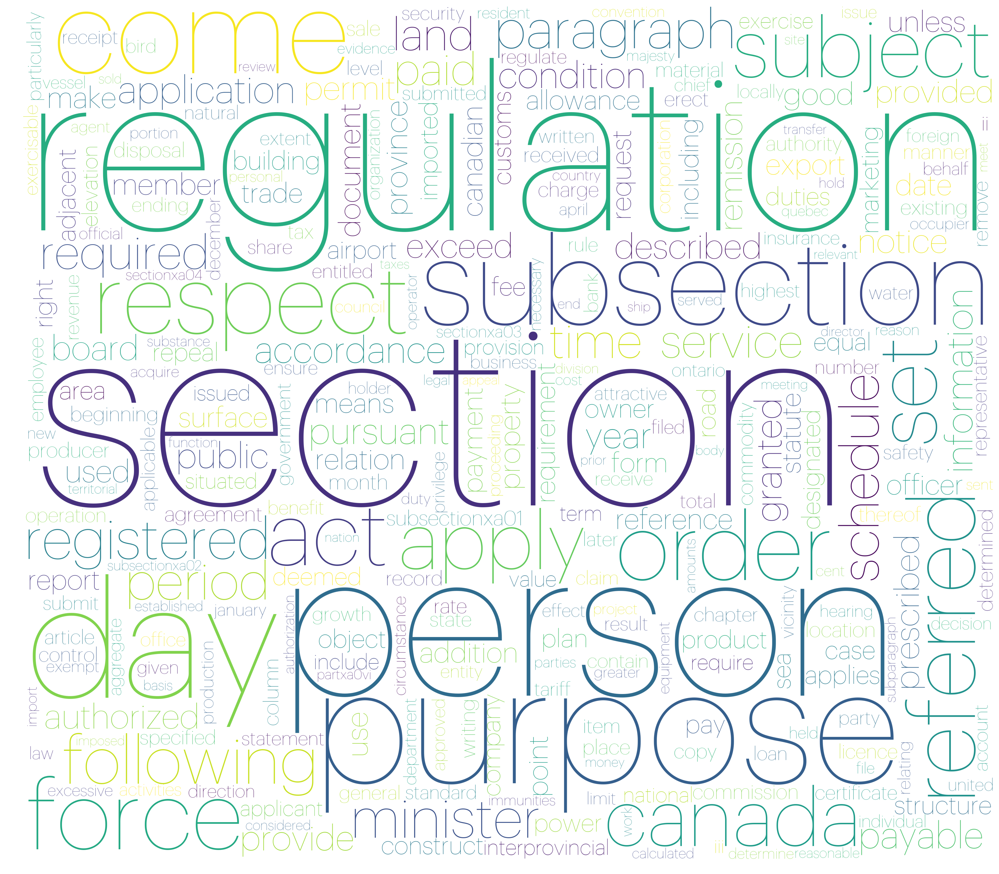

--------------Stemmed---------------


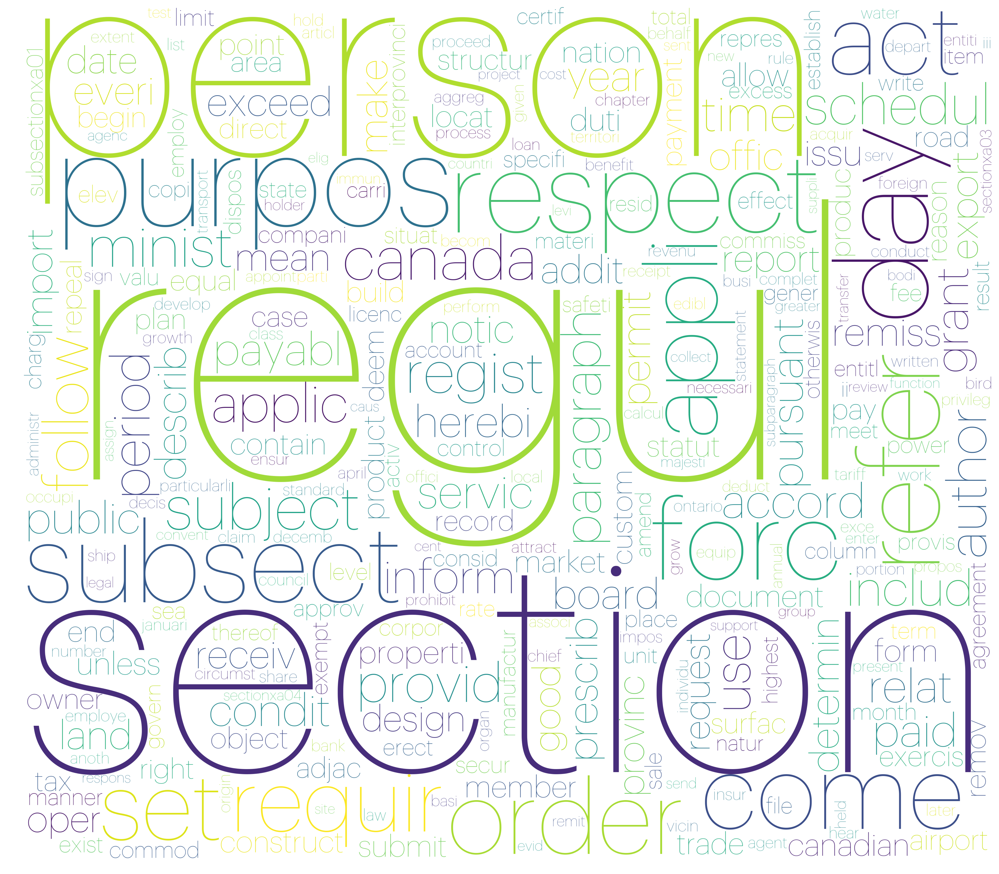

In [38]:
%matplotlib inline
print("--------------Filtered--------------")
wordcloud(filtered_topics_string)
print("--------------Stemmed---------------")
wordcloud(stemmed_topics_string)


## Next Steps
From here we can assess how many major topics show up across all documents and then start to eliminate them to balance out the word clouds. The theory being once we've eliminated the most common terms, we have only differentiated features which will aid clustering